# 2.1 Exploratory Data Analysis

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy import stats
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity

sns.set_theme(style="darkgrid", palette="husl")

## Introduction <a id='introduction'></a>
In this notebook, we will build on the low-level analysis performed in the 2.0-EDA.ipynb notebook. At this point, we have joined our data into unified sets. We have a dataset all_data.csv that contains the information for all schools from the census, expenditures, and the change, enroll, final, frl datasets. There is also the high_school.csv dataset which only includes the high schools from the all_data and is joined with the coact and remediation datasets. We will be looking at relationships between data that has been provided in each of the datasets and test hypotheses.

Specifically, we will
- Compare federal estimates of population size to school records,
- Compare the number of students in poverty to the number of students receiving free or reduced price lunches as well as the amount of money being spent in support programs
- Examine the performance of students in minorities to make recommendations for outreach programs
- Demonstrate evidence for the effect of ependitures as well as their types on performance

## Table of Contents
* [Introduction](#introduction)
* [1 Load Data](#load)
* [2 Federal and School Record Population Size Comparison](#compare)
* [3 Poverty in Schools](#poverty)
    * [3.1 Poverty and Spending](#poverty-spending)
    * [3.2 Poverty and Free or Reduce Lunches](#poverty-frl)
    * [3.3 Poverty and Ethnicities](#poverty-ethnicity)
* [Conclusion](#conclusion)

## 1 Load Data <a id='load'></a>
We will read in the all_data.csv and the high_school.csv datasets, and preview them.

In [357]:
all_data = pd.read_csv('../data/interim/all_data.csv')
high_school = pd.read_csv('../data/interim/high_school.csv')

In [3]:
all_data.head()

,district_id,est_child_poverty,est_total_child,est_total_pop,year,child_pov_ratio,child_adult_ratio,county,instruction_total,support_total,...,pct_amind,pct_asian,pct_black,pct_hisp,pct_white,pct_pi,pct_2ormore,pct_fr,district_name,school
0,880.0,22978.0,85901.0,604414.0,2010,0.267494,0.142123,DENVER,438251412.0,369798031.0,...,0.009326,0.029016,0.009845,0.916580,0.031606,0.000518,0.003109,0.9300,DENVER COUNTY 1,ABRAHAM LINCOLN HIGH SCHOOL
1,880.0,21750.0,88725.0,619968.0,2011,0.245139,0.143112,DENVER,445458597.0,384559117.0,...,0.009326,0.029016,0.009845,0.916580,0.031606,0.000518,0.003109,0.9300,DENVER COUNTY 1,ABRAHAM LINCOLN HIGH SCHOOL
2,880.0,26358.0,90920.0,634265.0,2012,0.289903,0.143347,DENVER,474517651.0,382873858.0,...,0.007357,0.026800,0.009984,0.913295,0.037835,0.001051,0.003678,0.9296,DENVER COUNTY 1,ABRAHAM LINCOLN HIGH SCHOOL
3,880.0,22978.0,85901.0,604414.0,2010,0.267494,0.142123,DENVER,438251412.0,369798031.0,...,0.015015,0.015015,0.270270,0.351351,0.348348,0.000000,0.000000,1.0000,DENVER COUNTY 1,RIDGE VIEW ACADEMY CHARTER SCHOOL
4,880.0,21750.0,88725.0,619968.0,2011,0.245139,0.143112,DENVER,445458597.0,384559117.0,...,0.015015,0.015015,0.270270,0.351351,0.348348,0.000000,0.000000,1.0000,DENVER COUNTY 1,RIDGE VIEW ACADEMY CHARTER SCHOOL


In [4]:
all_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6216 entries, 0 to 6215
Data columns (total 44 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   district_id              6209 non-null   float64
 1   est_child_poverty        6092 non-null   float64
 2   est_total_child          6092 non-null   float64
 3   est_total_pop            6092 non-null   float64
 4   year                     6216 non-null   int64  
 5   child_pov_ratio          6092 non-null   float64
 6   child_adult_ratio        6092 non-null   float64
 7   county                   6092 non-null   object 
 8   instruction_total        6092 non-null   float64
 9   support_total            6092 non-null   float64
 10  community_total          6092 non-null   float64
 11  other_total              6092 non-null   float64
 12  sum_total                6092 non-null   float64
 13  instruction_per_pupil    6092 non-null   float64
 14  support_per_pupil       

In [5]:
all_data.describe().T

,count,mean,std,min,25%,50%,75%,max
district_id,6209.0,1.383974e+03,1.284890e+03,10.000000,5.600000e+02,1.040000e+03,1.760000e+03,9.000000e+03
est_child_poverty,6092.0,5.080484e+03,6.793011e+03,5.000000,3.750000e+02,2.622000e+03,6.681000e+03,2.635800e+04
est_total_child,6092.0,3.134197e+04,3.227795e+04,32.000000,2.726000e+03,2.140700e+04,5.458200e+04,9.092000e+04
est_total_pop,6092.0,1.891349e+05,2.080413e+05,167.000000,1.693000e+04,1.088300e+05,2.748700e+05,6.342650e+05
year,6216.0,2.010997e+03,8.144836e-01,2010.000000,2.010000e+03,2.011000e+03,2.012000e+03,2.012000e+03
child_pov_ratio,6092.0,1.715052e-01,8.326659e-02,0.033952,1.065293e-01,1.488374e-01,2.411091e-01,5.081081e-01
child_adult_ratio,6092.0,1.736996e-01,3.010923e-02,0.094262,1.466462e-01,1.691128e-01,1.958840e-01,2.508475e-01
instruction_total,6092.0,1.558039e+08,1.639947e+08,313302.000000,1.264187e+07,8.906612e+07,2.878083e+08,4.745177e+08
support_total,6092.0,1.115000e+08,1.230650e+08,401500.000000,8.919376e+06,6.457251e+07,1.495366e+08,3.845591e+08
community_total,6092.0,2.670206e+06,6.744608e+06,-4300.000000,3.730000e+03,2.546380e+05,1.003119e+06,2.659835e+07


In [6]:
high_school.head()

,district_id,school_id,eng_yn,math_yn,read_yn,sci_yn,year,pct_remediation,est_child_poverty,est_total_child,...,pct_amind,pct_asian,pct_black,pct_hisp,pct_white,pct_pi,pct_2ormore,pct_fr,district_name,school
0,10,309,0.0,0.0,0.0,0.0,2010,NaN,1069.0,6160.0,...,0.003215,0.032154,0.012862,0.710611,0.234727,0.000000,0.006431,0.733,MAPLETON 1,SKYVIEW ACADEMY HIGH SCHOOL
1,20,15,1.0,0.0,0.0,0.0,2010,NaN,4446.0,41735.0,...,0.003063,0.025268,0.006891,0.250383,0.706738,0.001531,0.006126,0.155,ADAMS 12 FIVE STAR,ACADEMY OF CHARTER SCHOOLS
2,20,4108,1.0,0.0,0.0,0.0,2010,0.386667,4446.0,41735.0,...,0.001103,0.008274,0.002758,0.241589,0.745174,0.000000,0.001103,0.099,ADAMS 12 FIVE STAR,HORIZON HIGH SCHOOL
3,20,5043,1.0,0.0,0.0,0.0,2010,0.235060,4446.0,41735.0,...,0.003460,0.056846,0.010875,0.156698,0.767672,0.000494,0.003955,0.152,ADAMS 12 FIVE STAR,LEGACY HIGH SCHOOL
4,20,5816,1.0,0.0,0.0,0.0,2010,0.433566,4446.0,41735.0,...,0.001703,0.010783,0.010216,0.569240,0.403519,0.000568,0.003973,0.379,ADAMS 12 FIVE STAR,THORNTON HIGH SCHOOL


In [7]:
high_school.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 516 entries, 0 to 515
Data columns (total 49 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   district_id              516 non-null    int64  
 1   school_id                516 non-null    int64  
 2   eng_yn                   516 non-null    float64
 3   math_yn                  516 non-null    float64
 4   read_yn                  516 non-null    float64
 5   sci_yn                   516 non-null    float64
 6   year                     516 non-null    int64  
 7   pct_remediation          474 non-null    float64
 8   est_child_poverty        514 non-null    float64
 9   est_total_child          514 non-null    float64
 10  est_total_pop            514 non-null    float64
 11  child_pov_ratio          514 non-null    float64
 12  child_adult_ratio        514 non-null    float64
 13  county                   514 non-null    object 
 14  instruction_total        5

In [8]:
high_school.describe().T

,count,mean,std,min,25%,50%,75%,max
district_id,516.0,1.330595e+03,1.000521e+03,1.000000e+01,5.500000e+02,1.060000e+03,1.790000e+03,8.001000e+03
school_id,516.0,4.587967e+03,2.806435e+03,1.000000e+01,2.179000e+03,4.423500e+03,7.114000e+03,9.799000e+03
eng_yn,516.0,6.860465e-01,4.645481e-01,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00
math_yn,516.0,1.414729e-01,3.488469e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
read_yn,516.0,2.906977e-01,4.545249e-01,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00
sci_yn,516.0,2.906977e-02,1.681652e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
year,516.0,2.010988e+03,8.148265e-01,2.010000e+03,2.010000e+03,2.011000e+03,2.012000e+03,2.012000e+03
pct_remediation,474.0,3.614535e-01,1.643442e-01,0.000000e+00,2.400000e-01,3.291790e-01,4.700000e-01,9.069770e-01
est_child_poverty,514.0,4.522543e+03,5.894079e+03,3.300000e+01,5.750000e+02,2.564000e+03,5.751750e+03,2.635800e+04
est_total_child,514.0,3.040607e+04,3.117028e+04,2.480000e+02,3.741750e+03,1.858300e+04,4.294350e+04,9.092000e+04


In [9]:
num_only_ad = all_data.select_dtypes(include=['int', 'float']).drop(['district_id', 'school_id'], axis=1)
num_only_hs = high_school.select_dtypes(include=['int', 'float']).drop(['district_id', 'school_id'], axis=1)

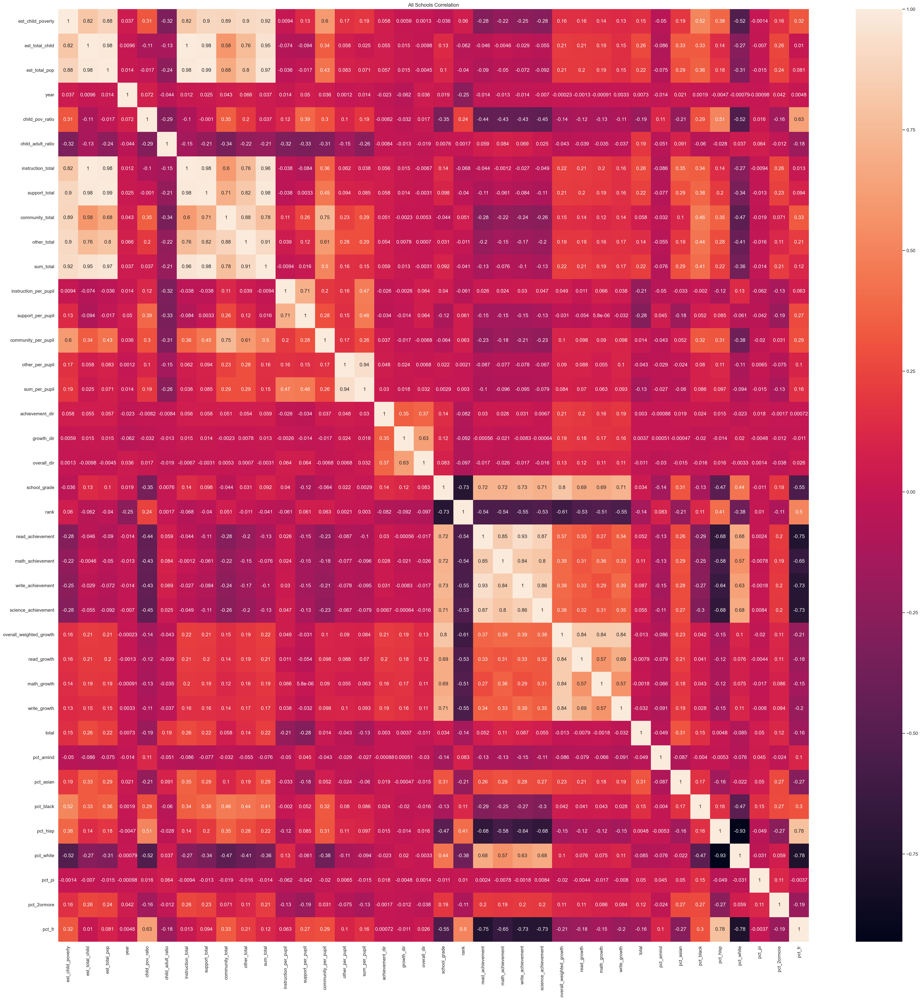

In [10]:
fig, ax = plt.subplots(1,1, figsize=(40,40), dpi=200)
sns.heatmap(num_only_ad.corr(numeric_only=True), ax=ax, annot=True)
ax.set_title('All Schools Correlation')
plt.show()

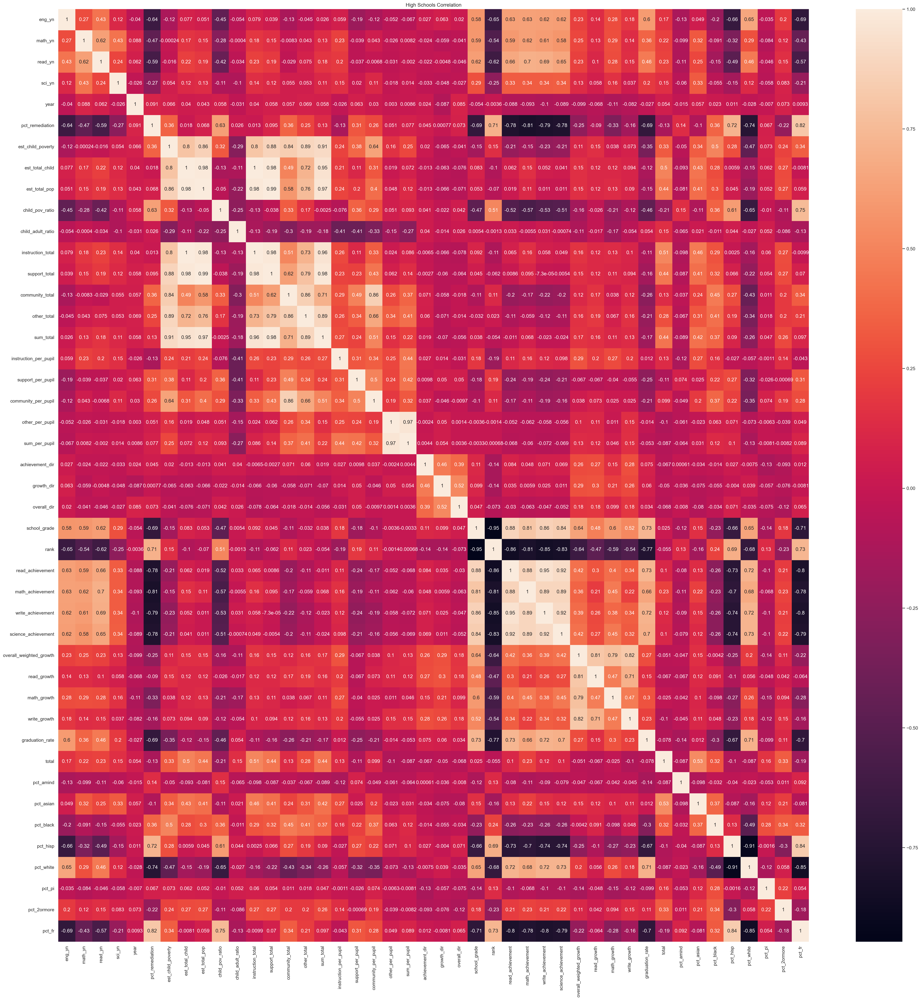

In [11]:
fig, ax = plt.subplots(1,1, figsize=(40,40), dpi=200)
sns.heatmap(num_only_hs.corr(numeric_only=True), ax=ax, annot=True)
ax.set_title('High Schools Correlation')
plt.show()

From these we conlcude that
* Out of all ependitures, instruction spending is most correlated with performance metrics
* Diversity measurements have a surprising amount of correlation with most features
* Federal poverty estimates are highly correlated with total amounts of spending and some correlation with per pupil amounts of spending
* The ratio of children in poverty has high correlation with achievement metrics 

In [360]:
# X axis of grid will show hues of college readiness for each subject on the ACT
college_readiness = ['eng_yn',
                    'math_yn',
                    'read_yn',
                    'sci_yn']
college_readiness_names = ['English Readiness',
                           'Math Readiness',
                           'Reading Readiness',
                           'Science Readiness']

ethnicities = ['pct_amind', 
               'pct_asian',
               'pct_black',
               'pct_hisp',
               'pct_white',
               'pct_pi',
               'pct_2ormore']
ethnicity_names = ['Percent American Indian',
                  'Percent Asian',
                  'Percent Black',
                  'Percent Hispanic',
                  'Percent White',
                  'Percent Pacific Islander',
                  'Percent Two or More']

achievements = ['read_achievement', 'math_achievement', 'write_achievement', 'science_achievement', 'school_grade']
achievement_names = ['Readng Achievement', 'Math Achievement', 'Writing Achievement', 'Science Achievement', 'School Grade']
growths = ['read_growth', 'math_growth', 'write_growth', 'overall_weighted_growth']
growth_names = ['Reading Growth', 'Math Growth', 'Writing Growth', 'Overall Growth']

#spending = ['instruction_per_pupil','']

In [361]:
high_school_grade_cols = college_readiness + ['pct_remediation']
high_grades = high_school.corr(numeric_only=True)['pct_hisp'].loc[high_school_grade_cols]
high_grades.index = college_readiness_names + ['Percent Remediation']

all_grade_cols = achievements + growths
all_school_grades = all_data.corr(numeric_only=True)['pct_hisp'].loc[all_grade_cols]
all_school_grades.index = achievement_names + growth_names

all_grades = pd.concat((high_grades, all_school_grades))
all_grades['Percent College Ready'] = -all_grades['Percent Remediation']
all_grades = all_grades.drop('Percent Remediation')

all_grades = all_grades.sort_values()

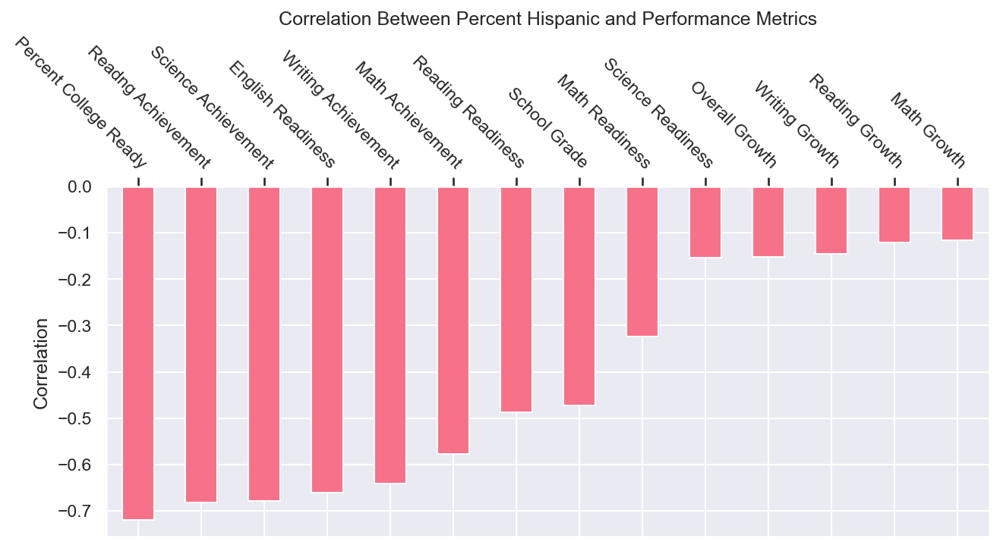

In [403]:
fig, ax = plt.subplots(dpi=150, figsize=(10,4))
all_grades.plot(kind='bar', ax=ax)
ax.set_title('Correlation Between Percent Hispanic and Performance Metrics')
ax.set_ylabel('Correlation')
ax.tick_params(top=True, labeltop=True, bottom=False, labelbottom=False)
ax.set_xticklabels(all_grades.index, rotation=-45, ha='right', rotation_mode='anchor')
plt.show()

fig.savefig('../reports/figures/pct_hisp_corr.png', bbox_inches='tight')

## 2 Federal and School Record Population Size Comparison<a id="compare"></a>

The saipe census datasets provide an estimate of student population size for each district. In the kaggle datasets, the total number of students at a school is reported. We want to offer justification that the saipe and kaggle datasets can be accurately joined. In order to do that, we will take the average of student population sizes for districts at each either and examine the distributions and their differences.

In [13]:
# Takes the average of est_total_child across all years
est_total_child = all_data[['district_id','est_total_child', 'year']].groupby('district_id')['est_total_child'].mean()

# Finds the size of the districts for each year from school sizes,
# Then averages the size of districts across all years
total_child = all_data.groupby(['district_id','year'])['total'].sum().reset_index().groupby('district_id')['total'].mean()

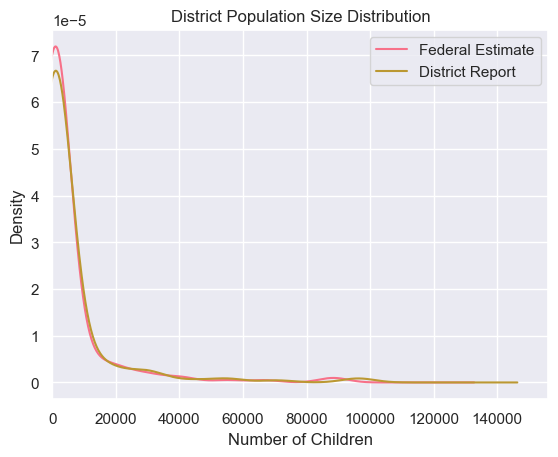

In [236]:
fig, ax = plt.subplots(1,1)
est_total_child.plot.kde(ax=ax, label='Federal Estimate')
total_child.plot.kde(ax=ax, label='District Report')
ax.set_xlim(left=0)
ax.set_title('District Population Size Distribution')
ax.set_xlabel('Number of Children')
ax.legend()
fig.savefig('../reports/figures/district_population_size_distribution.png')
plt.show()

In [15]:
total_child

district_id
10.0      14364.666667
20.0      56995.000000
30.0       8002.333333
40.0      17545.000000
50.0       1175.000000
              ...     
3210.0      918.333333
3220.0      207.666667
3230.0      122.666667
8001.0    13936.666667
9000.0        0.000000
Name: total, Length: 180, dtype: float64

In [16]:
est_total_child

district_id
10.0       6293.710843
20.0      42415.781421
30.0       8404.600000
40.0      16671.587500
50.0       1308.666667
              ...     
3210.0      732.333333
3220.0       92.666667
3230.0       69.666667
8001.0             NaN
9000.0             NaN
Name: est_total_child, Length: 180, dtype: float64

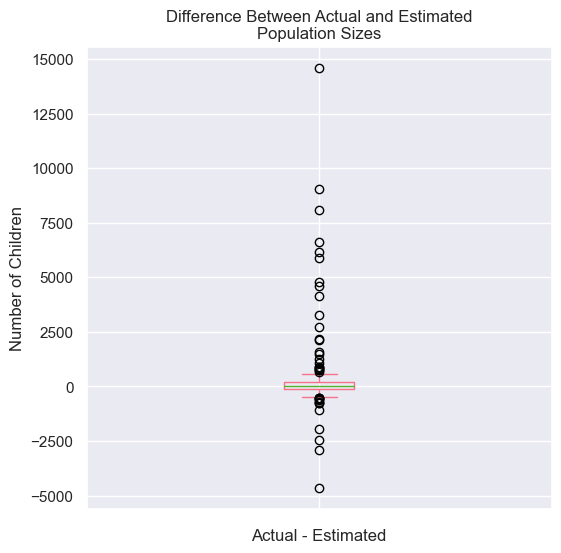

In [154]:
est_act_diff_pct = total_child - est_total_child

plt.figure(figsize=(6,6), dpi=100)
est_act_diff.plot.box()
plt.title('Difference Between Actual and Estimated\nPopulation Sizes')
plt.xlabel('Actual - Estimated')
plt.ylabel('Number of Children')
plt.show()

In [18]:
total_child.describe()

count      180.000000
mean      5394.733333
std      14100.969367
min          0.000000
25%        316.083333
50%        688.000000
75%       2428.000000
max      97550.666667
Name: total, dtype: float64

In [19]:
est_total_child.describe()

count      178.000000
mean      4992.407300
std      13022.252971
min         32.705882
25%        209.519231
50%        616.940559
75%       2551.166667
max      88495.982699
Name: est_total_child, dtype: float64

From this we can be reasonably confident in the synchronicity of the census report and the kaggle datasets. Their distributions appear similar, the difference between them is highly centered at 0, and the max difference between them is only about one standard deviation of the populations.

## 3 Poverty in Schools <a id="poverty"></a>
We will examine 
- how poverty affects spending
- whether or not schools with more poverty provide free and reduced lunches
- the relationships between poverty and ethnicities

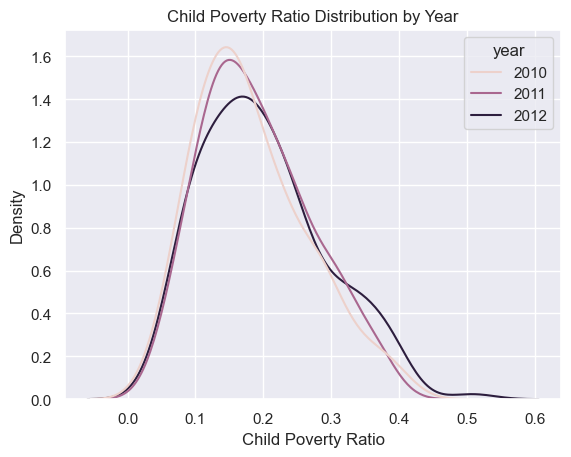

In [20]:
district_data = all_data.groupby(['district_id', 'year']).mean(numeric_only=True).reset_index()
sns.kdeplot(data=district_data, x='child_pov_ratio', hue='year')
plt.title('Child Poverty Ratio Distribution by Year')
plt.xlabel('Child Poverty Ratio')
plt.show()

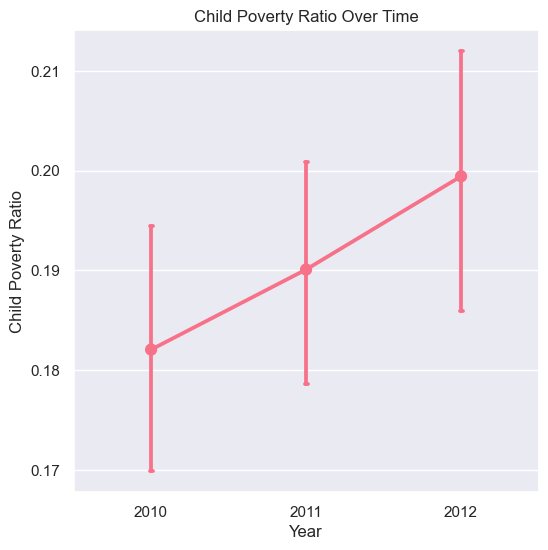

In [237]:
fig = plt.figure(figsize=(6,6), dpi=100)
plt.title('Child Poverty Ratio Over Time')
sns.pointplot(district_data, x='year', y='child_pov_ratio', capsize=.02)
plt.xlabel('Year')
plt.ylabel('Child Poverty Ratio')
plt.show()

fig.savefig('../reports/figures/child_poverty_over_time.png')

It seems like child poverty might be increasing

In [22]:
pov_2010 = district_data.loc[district_data['year'] == 2010, 'child_pov_ratio'].dropna()
pov_2011 = district_data.loc[district_data['year'] == 2011, 'child_pov_ratio'].dropna()
pov_2012 = district_data.loc[district_data['year'] == 2012, 'child_pov_ratio'].dropna()

print(stats.skew(pov_2010))
print(stats.skew(pov_2011))
print(stats.skew(pov_2012))

print('2010 to 2011 Results', stats.ttest_ind(pov_2010, pov_2011, alternative='less'))
print('2011 to 2012 Results', stats.ttest_ind(pov_2011, pov_2012, alternative='less'))
print('2010 to 2012 results', stats.ttest_ind(pov_2010, pov_2012, alternative='less'))

0.6320777969766798
0.4434408994921169
0.6136108196383343
2010 to 2011 Results Ttest_indResult(statistic=-0.9301111080296215, pvalue=0.17647369180575967)
2011 to 2012 Results Ttest_indResult(statistic=-1.0288438986675832, pvalue=0.1521277411962177)
2010 to 2012 results Ttest_indResult(statistic=-1.8863427880199393, pvalue=0.03003353707758271)


It seems that the child poverty ratio may hav increased between 2010 and 2012 considering our p-value is 0.03 which is drastically higher than the difference between any two years. However, we would need to see this pattern persist in the 2013 school year to more confidently assert that child poverty ratio is increasing

### 3.1 Poverty and Spending <a id="poverty-spending"></a>

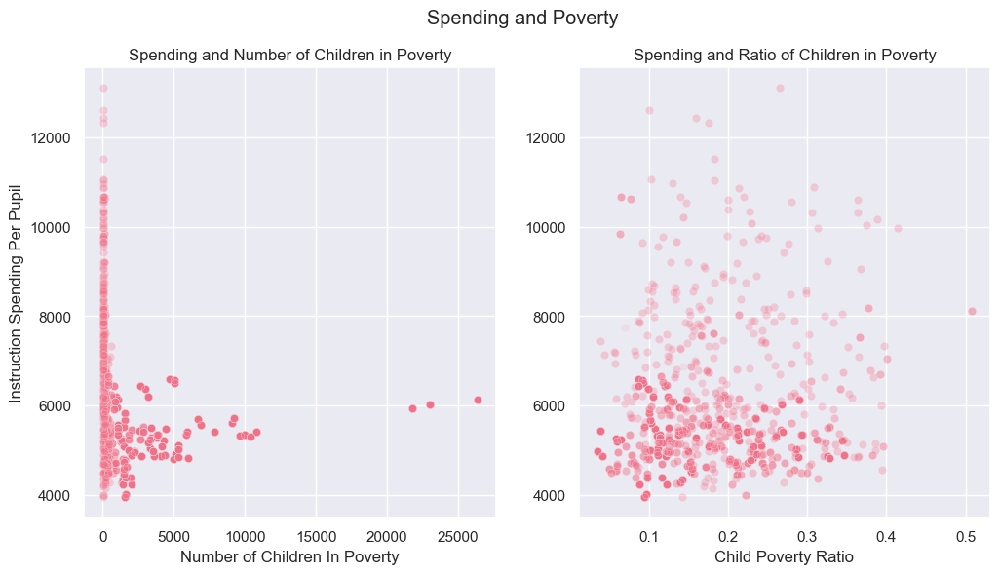

In [23]:
fig, ax = plt.subplots(1,2, figsize=(12,6), dpi=100)
fig.suptitle('Spending and Poverty')
# Spending compared to number of children in poverty
sns.scatterplot(data=all_data, x='est_child_poverty', y='instruction_per_pupil', ax=ax[0], alpha=0.1)
ax[0].set_title('Spending and Number of Children in Poverty')
ax[0].set_ylabel('Instruction Spending Per Pupil')
ax[0].set_xlabel('Number of Children In Poverty')
# Spending compared to ratio of children in poverty
sns.scatterplot(data=all_data, x='child_pov_ratio', y='instruction_per_pupil', ax=ax[1], alpha=0.1)
ax[1].set_title('Spending and Ratio of Children in Poverty')
ax[1].set_xlabel('Child Poverty Ratio')
ax[1].set_ylabel('')
plt.show()

Initially, we observe that almost all school districts that spend high amounts per pupil have close to 0 children in poverty. However, this pattern seems to break down when considering the ratio of children in poverty. The high spending districts spread out among different child poverty ratios

### 3.2 Poverty and Free and Reduced Lunches <a id="poverty-frl"></a>

In [24]:
x = all_data['child_pov_ratio'] + np.random.normal(0,0.007,all_data['child_pov_ratio'].shape)

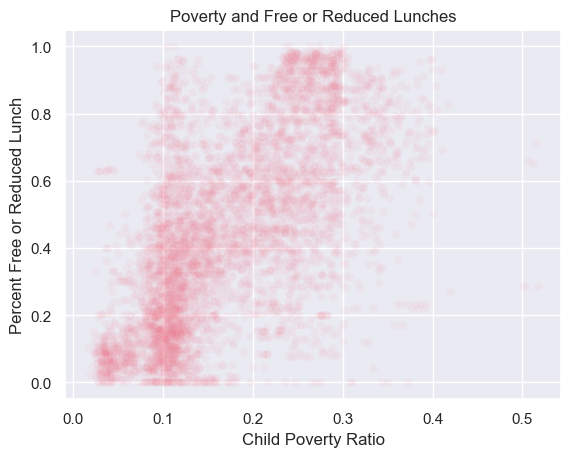

In [238]:
fig = plt.figure(dpi=100)
sns.scatterplot(data=all_data, x=x, y='pct_fr', alpha=0.05)
plt.title('Poverty and Free or Reduced Lunches')
plt.xlabel('Child Poverty Ratio')
plt.ylabel('Percent Free or Reduced Lunch')
plt.show()

fig.savefig('../reports/figures/poverty_and_frl.png')

It seems that schools are providing free or reduced lunch prices well. In fact, they seem to be offering free or reduce price lunches at a faster rate than the ratio of children in poverty. Furthermore, it appears there could be weak clusters at schools offering to the majority of students and the minority of students

### 3.3 Poverty and Ethnicities <a id="poverty-ethnicity"></a>

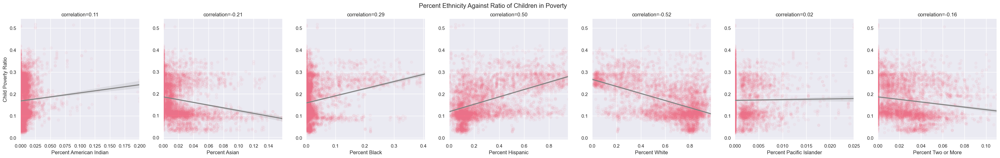

In [26]:
fig, ax = plt.subplots(1, len(ethnicities), figsize=(40, 5), dpi=100)
fig.suptitle('Percent Ethnicity Against Ratio of Children in Poverty')
for i in range(len(ethnicities)):
    sns.regplot(data=all_data, y=x, x=ethnicities[i], scatter_kws={'alpha':0.05}, ax=ax[i], line_kws={'color': 'grey'})
    correlation = all_data[ethnicities[i]].corr(x)
    ax[i].set_title(f'{correlation=:0.2f}')
    ax[i].set_xlabel(ethnicity_names[i])
    ax[i].set_xlim(left=0, right=all_data[ethnicities[i]].quantile(.995))
    ax[i].set_ylabel('')
ax[0].set_ylabel('Child Poverty Ratio')
plt.show()

It seems that schools with higher percentages of black and hispanic students struggle more with poverty while higher percentage white schools struggle less with poverty.
In addition, it appears that there are weak clusters of high percentage white school and low percentage white schools

In [215]:
stats.normaltest(all_data['pct_white'].dropna())

NormaltestResult(statistic=852.1800181769688, pvalue=8.9425269729195e-186)

In [411]:
# Determine ethnicitiy percentages across all schools
ethnicity_totals = ['num_amind', 
                   'num_asian',
                   'num_black',
                   'num_hisp',
                   'num_white',
                   'num_pi',
                   'num_2ormore']

assert len(ethnicities) == len(ethnicity_totals)

for i in range(len(ethnicities)):
    all_data[ethnicity_totals[i]] = all_data[ethnicities[i]] * all_data['total']
    
overall_ethnicity_percentages = all_data[ethnicity_totals].sum(axis=0) / all_data['total'].sum()
overall_ethnicity_percentages

new_index = ['Percent American Indian',
            'Percent Asian',
            'Percent Black',
            'Percent Hispanic',
            'Percent White',
            'Percent Pacific Islander',
            'Percent Two Or More']
pd.Series(data=overall_ethnicity_percentages.values, index=new_index, name='Statewide Demographics').to_latex('../reports/tables/statewide_demographics')


C:\Users\caeley\AppData\Local\Temp\ipykernel_17944\3944882885.py:25: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  pd.Series(data=overall_ethnicity_percentages.values, index=new_index, name='Statewide Demographics').to_latex('../reports/tables/statewide_demographics')


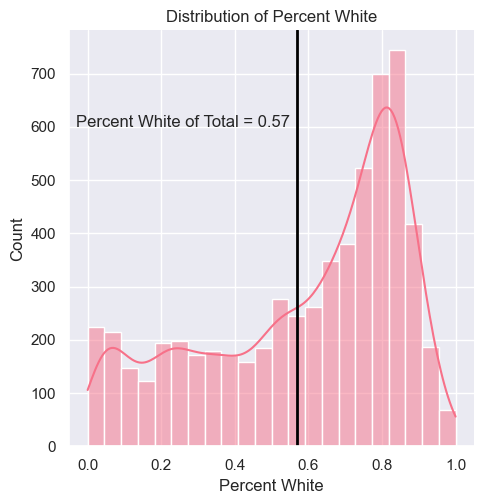

In [309]:
fig = sns.displot(data=all_data, x='pct_white', kde=True)
fig.figure.set_dpi(100)
plt.axvline(overall_ethnicity_percentages['num_white'], c='k', linewidth=2)
plt.text(overall_ethnicity_percentages['num_white']-0.6, 600, f'Percent White of Total = {overall_ethnicity_percentages["num_white"]:0.2f}')
plt.title(f'Distribution of Percent White')
plt.xlabel('Percent White')
plt.show()
fig.savefig('../reports/figures/pct_white.png')

We clearly observe that there are a significant number of schools whose percent white far above the mean and below the mean. The distribution has a strong negative skew

In [196]:
ethnicity_pct_mat = np.ones(len(ethnicities)) * overall_ethnicity_percentages.values
cos_sim_to_pct_mat = lambda X: np.dot(X, ethnicity_pct_mat) / (np.linalg.norm(X) * np.linalg.norm(ethnicity_pct_mat))
all_data['Diversity Score'] = all_data[ethnicities].apply(cos_sim_to_pct_mat, axis=1)
high_school['Diversity Score'] = high_school[ethnicities].apply(cos_sim_to_pct_mat, axis=1)

In [126]:
all_data.iloc[all_data['Diversity Score'].idxmax()][ethnicities]

pct_amind      0.006472
pct_asian      0.012945
pct_black      0.045307
pct_hisp       0.325243
pct_white      0.595469
pct_pi         0.004854
pct_2ormore    0.009709
Name: 3183, dtype: object

In [127]:
all_data.iloc[all_data['Diversity Score'].idxmin()][ethnicities + ['Diversity Score']]

pct_amind          0.002778
pct_asian          0.002778
pct_black          0.686111
pct_hisp           0.236111
pct_white          0.036111
pct_pi                  0.0
pct_2ormore        0.036111
Diversity Score    0.272792
Name: 290, dtype: object

In [129]:
all_data.iloc[all_data['pct_white'].idxmax()]

district_id                                  960.0
est_child_poverty                              7.0
est_total_child                              102.0
est_total_pop                                672.0
year                                          2012
child_pov_ratio                           0.068627
child_adult_ratio                         0.151786
county                                      ELBERT
instruction_total                         313302.0
support_total                             401500.0
community_total                                0.0
other_total                                 4521.0
sum_total                                 719324.0
instruction_per_pupil                       7755.0
support_per_pupil                           9938.0
community_per_pupil                            0.0
other_per_pupil                              112.0
sum_per_pupil                              17805.0
emh                                              E
school_id                      

In [135]:
res = stats.bootstrap((all_data['Diversity Score'].dropna(),), np.mean)
lower, upper = res.confidence_interval[0], res.confidence_interval[1]
mu = all_data['Diversity Score'].mean()

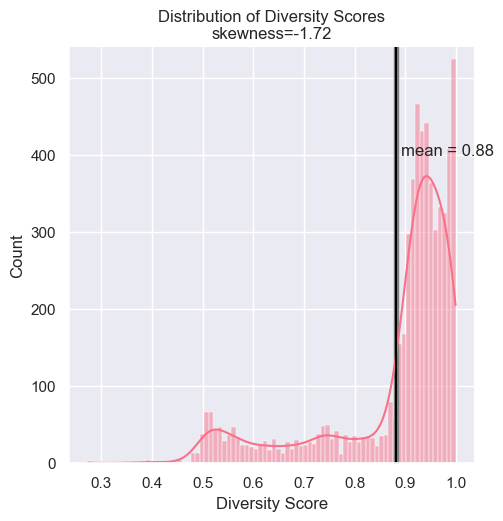

In [148]:
sns.displot(data=all_data, x='Diversity Score', kde=True)
skewness = stats.skew(all_data['Diversity Score'].dropna())
plt.title(f'Distribution of Diversity Scores\n{skewness=:0.2f}')
plt.axvline(mu, color='black')
plt.fill_betweenx([0, 540], lower, upper, color='grey')
plt.text(mu+0.01, 400, f'mean = {mu:0.2f}')
plt.ylim(top=540)
plt.show()

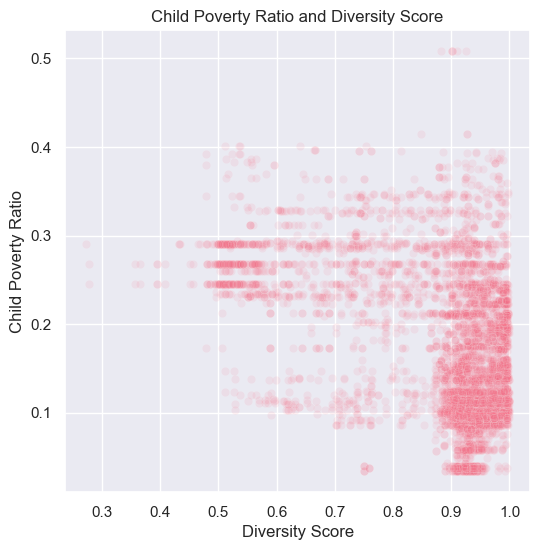

In [289]:
plt.figure(figsize=(6,6), dpi=100)
sns.scatterplot(data=all_data, x='Diversity Score', y='child_pov_ratio', alpha=0.1)
plt.title('Child Poverty Ratio and Diversity Score')
plt.ylabel('Child Poverty Ratio')
plt.show()

In [169]:
all_data.corr(numeric_only=True)['Diversity Score']

district_id                0.128793
est_child_poverty         -0.520532
est_total_child           -0.271176
est_total_pop             -0.319808
year                       0.006004
child_pov_ratio           -0.457257
child_adult_ratio          0.118702
instruction_total         -0.278546
support_total             -0.354196
community_total           -0.532405
other_total               -0.457723
sum_total                 -0.386515
instruction_per_pupil     -0.044349
support_per_pupil         -0.211226
community_per_pupil       -0.423325
other_per_pupil           -0.144294
sum_per_pupil             -0.183162
school_id                  0.033956
achievement_dir           -0.021920
growth_dir                 0.003261
overall_dir               -0.036940
school_grade               0.297123
rank                      -0.280198
read_achievement           0.536504
math_achievement           0.454691
write_achievement          0.507831
science_achievement        0.542720
overall_weighted_growth    0

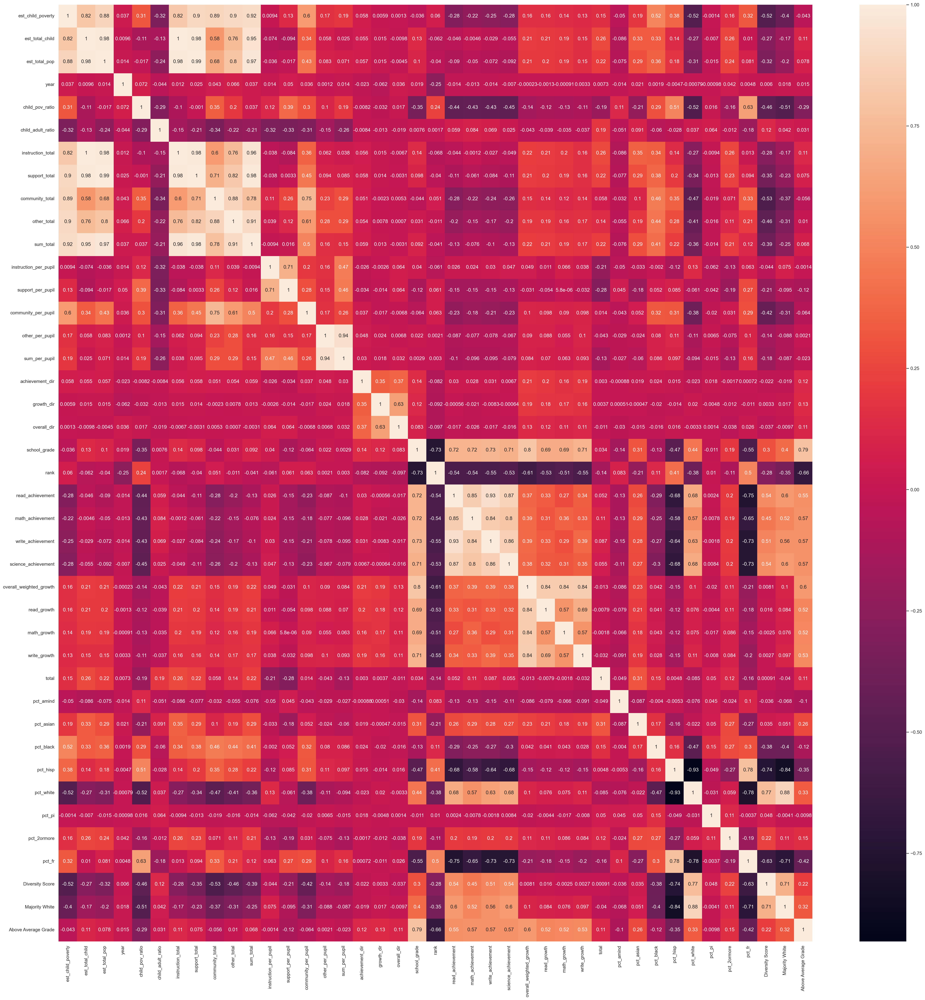

In [174]:
fig, ax = plt.subplots(1,1, figsize=(40,40), dpi=200)
sns.heatmap(all_data.drop(['school_id', 'district_id'] + ethnicity_totals, axis=1).corr(numeric_only=True),ax=ax, annot=True)
plt.show()

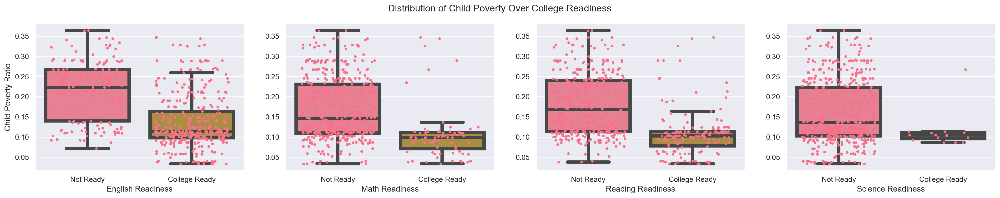

In [310]:
fig, ax = plt.subplots(1,len(college_readiness), figsize=(26,4), dpi=200)
fig.suptitle('Distribution of Child Poverty Over College Readiness')
for i in range(len(college_readiness)):
    sns.boxplot(data=high_school, y='child_pov_ratio', x=college_readiness[i], ax=ax[i], linewidth=5, showfliers=False)
    sns.stripplot(data=high_school, y='child_pov_ratio', x=college_readiness[i], ax=ax[i], jitter=0.35, size=4)
    ax[i].set_xticklabels(['Not Ready', 'College Ready'])
    ax[i].set_xlabel(college_readiness_names[i])
    ax[i].set_ylabel('')
ax[0].set_ylabel('Child Poverty Ratio')
plt.show()

fig.savefig('../reports/figures/poverty_and_readiness.png')

With this graph, the effect of poverty is more clear in college readiness

## 4 Child Adult Ratio

### 4.1 Child Adult Ratio and Child Poverty Ratio

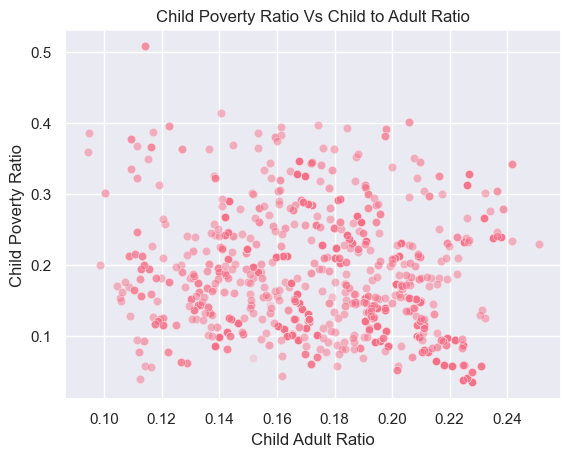

In [36]:
sns.scatterplot(data=all_data, x='child_adult_ratio', y='child_pov_ratio', alpha=0.2)
plt.title('Child Poverty Ratio Vs Child to Adult Ratio')
plt.xlabel('Child Adult Ratio')
plt.ylabel('Child Poverty Ratio')
plt.show()

### 4.2 Child Adult Ratio and Spending

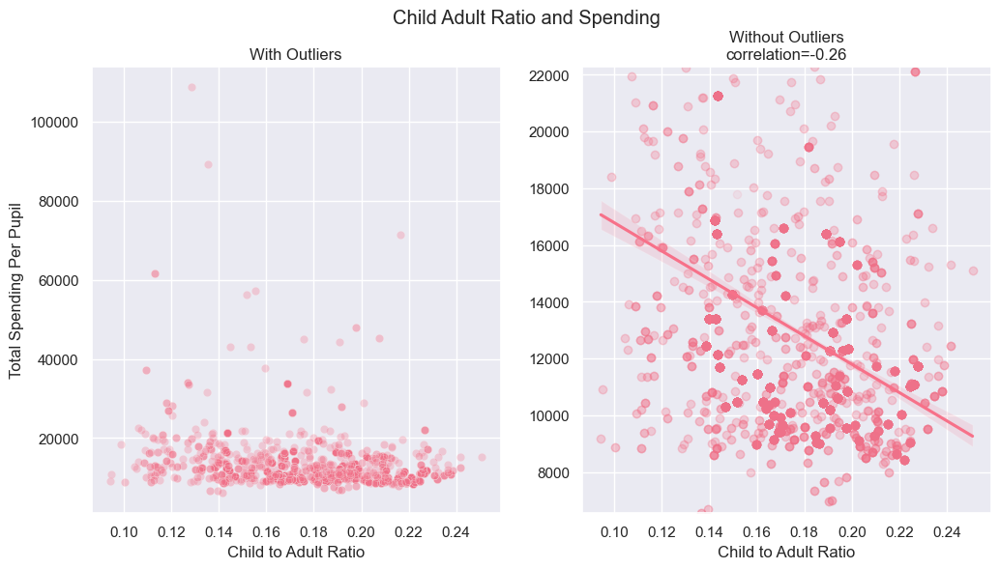

In [37]:
fig, ax = plt.subplots(1,2, figsize=(12,6), dpi=100)
fig.suptitle('Child Adult Ratio and Spending')
sns.scatterplot(data=all_data, x='child_adult_ratio', y='sum_per_pupil', ax=ax[0], alpha=0.1)
sns.regplot(data=all_data, x='child_adult_ratio', y='sum_per_pupil', ax=ax[1], scatter_kws={'alpha':0.1})
correlation = all_data['sum_per_pupil'].corr(all_data['child_adult_ratio'])
ax[0].set_title('With Outliers')
ax[0].set_ylabel('Total Spending Per Pupil')
ax[0].set_xlabel('Child to Adult Ratio')
ax[1].set_title(f'Without Outliers\n{correlation=:0.2f}')
ax[1].set_xlabel('Child to Adult Ratio')
ax[1].set_ylim(all_data['sum_per_pupil'].quantile(0.001), all_data['sum_per_pupil'].quantile(.975))
ax[1].set_ylabel('')
plt.show()

We have strong reason to believe that in areas where there are more children to adults, spending per student decreases

### 4.3 Child Adult Ratio and College Readiness

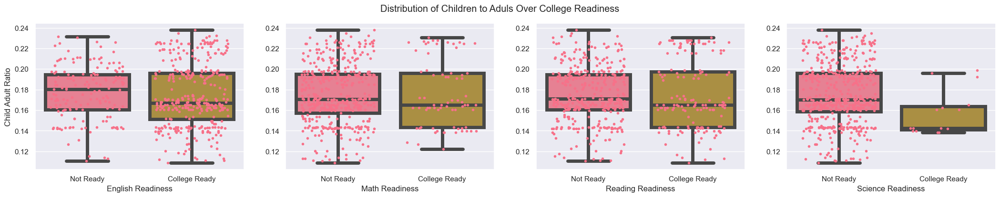

In [262]:
fig, ax = plt.subplots(1,len(college_readiness), figsize=(26,4), dpi=100)
fig.suptitle('Distribution of Children to Aduls Over College Readiness')
for i in range(len(college_readiness)):
    sns.boxplot(data=high_school, y='child_adult_ratio', x=college_readiness[i], ax=ax[i], linewidth=5, showfliers=False)
    sns.stripplot(data=high_school, y='child_adult_ratio', x=college_readiness[i], ax=ax[i], jitter=0.35, size=4)
    ax[i].set_xticklabels(['Not Ready', 'College Ready'])
    ax[i].set_xlabel(college_readiness_names[i])
    ax[i].set_ylabel('')
ax[0].set_ylabel('Child Adult Ratio')
plt.show()

In [266]:
for i in range(len(college_readiness)):
    ready_loc = high_school[college_readiness[i]].astype('bool')
    ready = high_school.loc[ready_loc, 'child_adult_ratio'].dropna()
    not_ready = high_school.loc[~(ready_loc), 'child_adult_ratio'].dropna()
    print(college_readiness_names[i], stats.mannwhitneyu(not_ready, ready, alternative='greater'))

English Readiness MannwhitneyuResult(statistic=30995.0, pvalue=0.049381324046069736)
Math Readiness MannwhitneyuResult(statistic=16814.5, pvalue=0.27077046350323786)
Reading Readiness MannwhitneyuResult(statistic=29414.5, pvalue=0.08361580905186133)
Science Readiness MannwhitneyuResult(statistic=5313.5, pvalue=0.0027920891545631806)


We observe that despite extreme outliers of spending per pupil, as the amount of children to adults increase, the total spending per pupil has a strong downwoard trend

## 5 Ethnicities

### 5.1 Ethnicities Over Time

In [38]:
for ethnicity in ethnicities:
    pct_2010 = all_data.loc[all_data['year'] == 2010, ethnicity].dropna()
    pct_2012 = all_data.loc[all_data['year'] == 2012, ethnicity].dropna()
    print(ethnicity, stats.ttest_ind(pct_2010, pct_2012, alternative='less'))

pct_amind Ttest_indResult(statistic=1.0464789644589243, pvalue=0.852298883432342)
pct_asian Ttest_indResult(statistic=-1.6309380941532252, pvalue=0.05149046317390182)
pct_black Ttest_indResult(statistic=-0.1490009085957525, pvalue=0.44078015720721864)
pct_hisp Ttest_indResult(statistic=0.36536163812628425, pvalue=0.6425697495949537)
pct_white Ttest_indResult(statistic=0.06098548464164838, pvalue=0.5243131149466616)
pct_pi Ttest_indResult(statistic=0.07598278923533616, pvalue=0.5302817332002379)
pct_2ormore Ttest_indResult(statistic=-3.320321406404324, pvalue=0.00045353823532777687)


We observe that over time, reported percentages of asian communities and those who identify as two or more ethnicities are raising over time

### 5.2 Ethnicities, College Readiness, and Child Poverty Ratio

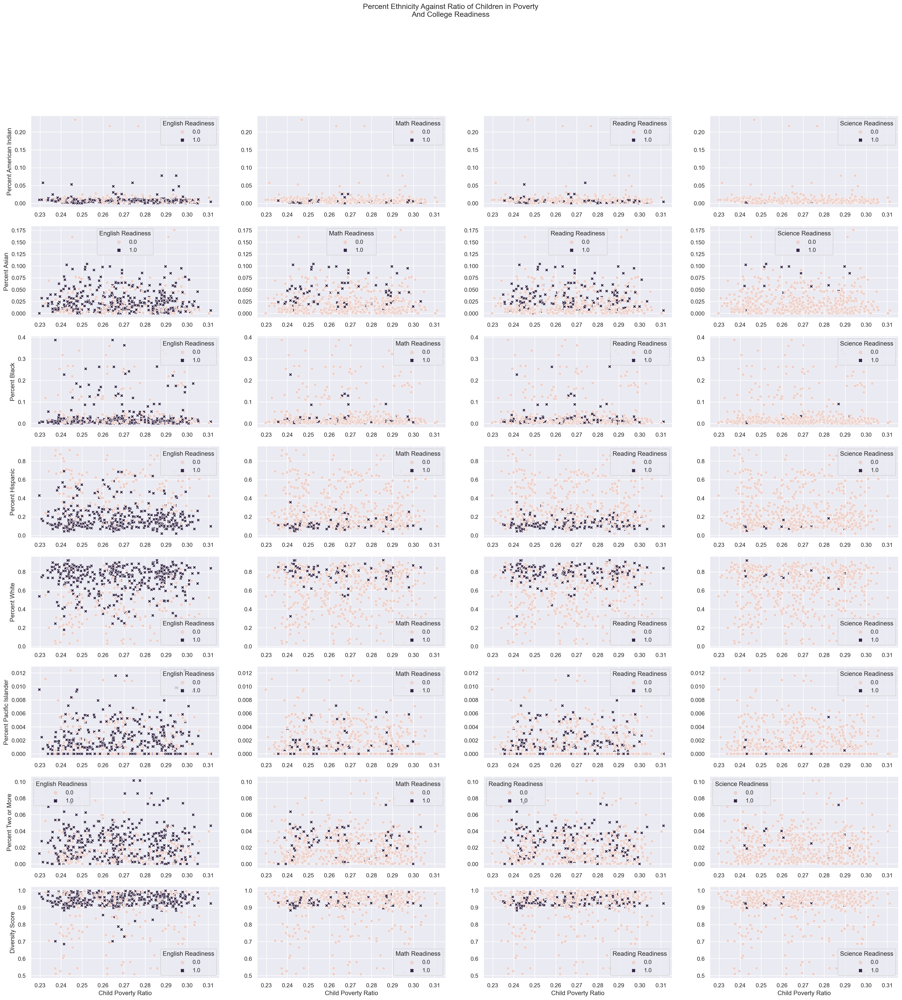

In [206]:
fig, ax = plt.subplots(len(ethnicities)+1,len(college_readiness), figsize=(30,30), dpi=200)
fig.suptitle('Percent Ethnicity Against Ratio of Children in Poverty\nAnd College Readiness')
for i in range(len(ethnicities)+1):
    ax[i,0].set_ylabel((ethnicity_names + ['Diversity Score'])[i])
    for j in range(len(college_readiness)):
        sns.scatterplot(data=high_school, x=x, y=(ethnicities + ['Diversity Score'])[i], alpha=1, ax=ax[i,j], hue=college_readiness[j], style=college_readiness[j])
        ax[i,j].legend(title=college_readiness_names[j])
        if j > 0:
            ax[i,j].set_ylabel('')
        if i == len(ethnicities):
            ax[i,j].set_xlabel('Child Poverty Ratio')
        else:
            ax[i,j].set_xlabel('')
plt.show()

It is clear that high percentage hispanic communities struggle immensely with 

### 5.3 Ethnicities and Percent Remediation

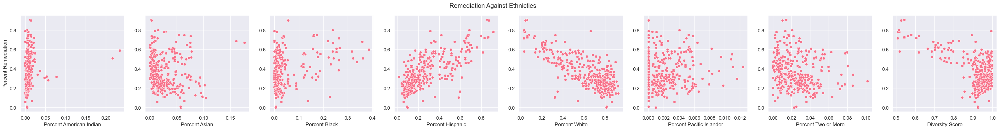

In [202]:
fig, ax = plt.subplots(1,len(ethnicities)+1, figsize=(40,4), dpi=100)
fig.suptitle('Remediation Against Ethnicties')
for i in range(len(ethnicities)+1):
    sns.scatterplot(data=high_school, y='pct_remediation', x=(ethnicities + ['Diversity Score'])[i], ax=ax[i])
    ax[i].set_xlabel((ethnicity_names + ['Diversity Score'])[i])
    ax[i].set_ylabel('')
ax[0].set_ylabel('Percent Remediation')
plt.show()

Most notably we observe an extreme upward trend in percent remediation as percent hispanic increases and a strong donward trend in percent white against percent remediation

### 5.4 Ethnicities, College Readniess, and Time

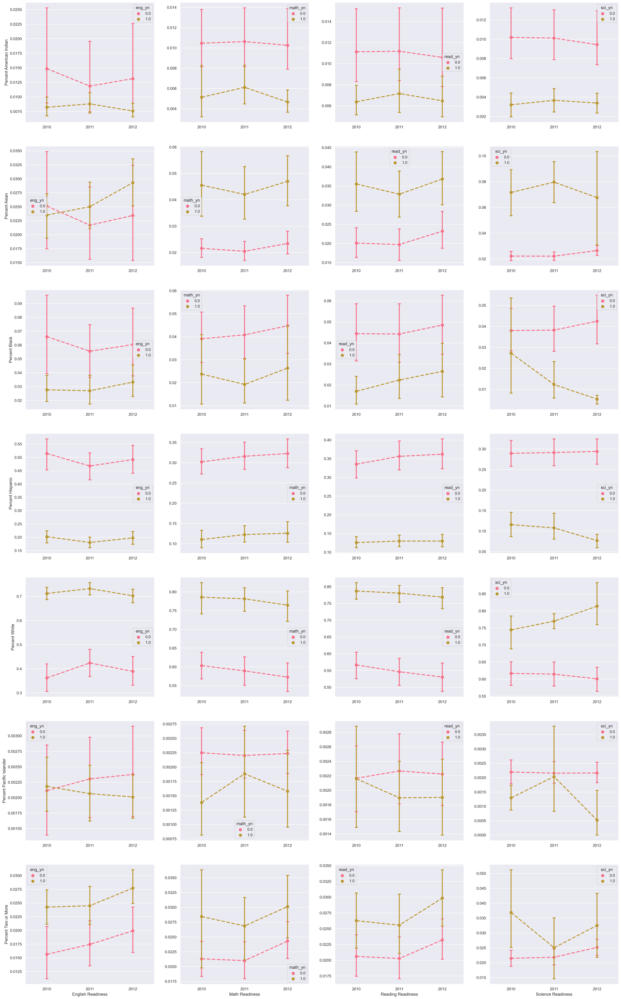

In [268]:
fig, ax = plt.subplots(len(ethnicities),len(college_readiness), figsize=(30,50), dpi=200)
#fig.suptitle('Ethnicities and College Readiness over Time')
for i in range(len(ethnicities)):
    for j in range(len(college_readiness)):
        sns.pointplot(data=high_school, hue=college_readiness[j], y=ethnicities[i], x='year', ax=ax[i,j], capsize=0.05, linestyles='--')
        # ax[i,j].set_xticklabels(['Not Ready', 'College Ready'])
        
        if j > 0:
            ax[i,j].set_ylabel('')
        else:
            ax[i,j].set_ylabel(ethnicity_names[i])
        if i < len(ethnicities) - 1:
            ax[i,j].set_xlabel('')
        else:
            ax[i,j].set_xlabel(college_readiness_names[j])
plt.show()

fig.savefig('../reports/figures/college_readiness_and_diversity_over_time.png')

We observe fairly noticable splits in college readiness among ethnicities. High percentage white and asian schools are most likely to score high on the ACT across all sections. High percentage asian schools do not do well on the english section but succeed in all other sections. High percentage hispanic communities struggle a lot to score well on the ACT (This could be a result of a language barrier). High percentage black schools struggle a lot in math, reading, and science. Schools with many students of two or more ethnicities do well on ACTs.

We see this supported by percent of remediation

Poverty ratios seem to have little affect on college readiness across all communities

### 5.5 Diversity Score and College Readiness

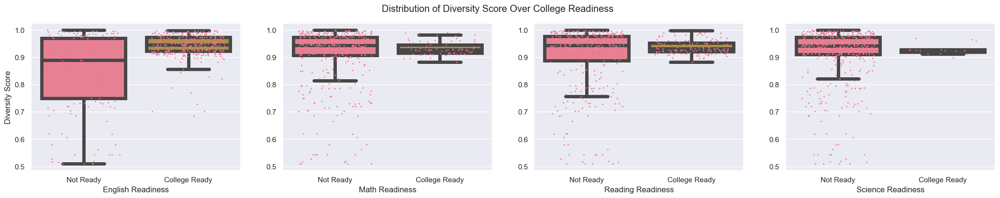

In [205]:
fig, ax = plt.subplots(1,len(college_readiness), figsize=(26,4), dpi=100)
fig.suptitle('Distribution of Diversity Score Over College Readiness')
for i in range(len(college_readiness)):
    sns.boxplot(data=high_school, y='Diversity Score', x=college_readiness[i], ax=ax[i], linewidth=5, showfliers=False)
    sns.stripplot(data=high_school, y='Diversity Score', x=college_readiness[i], ax=ax[i], jitter=0.35, size=2)
    ax[i].set_xticklabels(['Not Ready', 'College Ready'])
    ax[i].set_xlabel(college_readiness_names[i])
    ax[i].set_ylabel('')
ax[0].set_ylabel('Diversity Score')
plt.show()

### 5.6 Percent Readiness Over Time

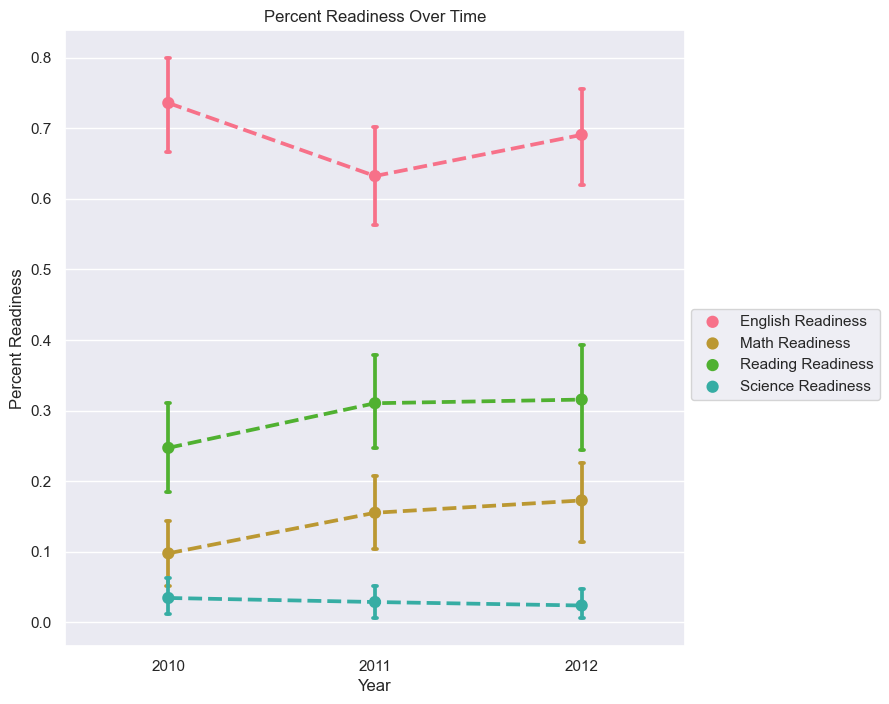

In [252]:
fig, ax = plt.subplots(figsize=(8,8), dpi=100)
ax.set_title('Percent Readiness Over Time')
for i in range(len(college_readiness)):
    sns.pointplot(data=high_school, x='year', y=college_readiness[i], ax=ax, label=college_readiness_names[i], linestyles='--', color=sns.husl_palette()[i], capsize=.02)
ax.set_xlabel('Year')
ax.set_ylabel('Percent Readiness')
ax.legend(loc=(1.01,.4))
plt.show()

fig.savefig('../reports/figures/readiness_over_time.png')

The percentage of schools that are college ready seems to be relatively constant over time. This also provides concrete evidence that schools are performing very well in english and very poorly in science

### 5.7 Ethnicities and Grades

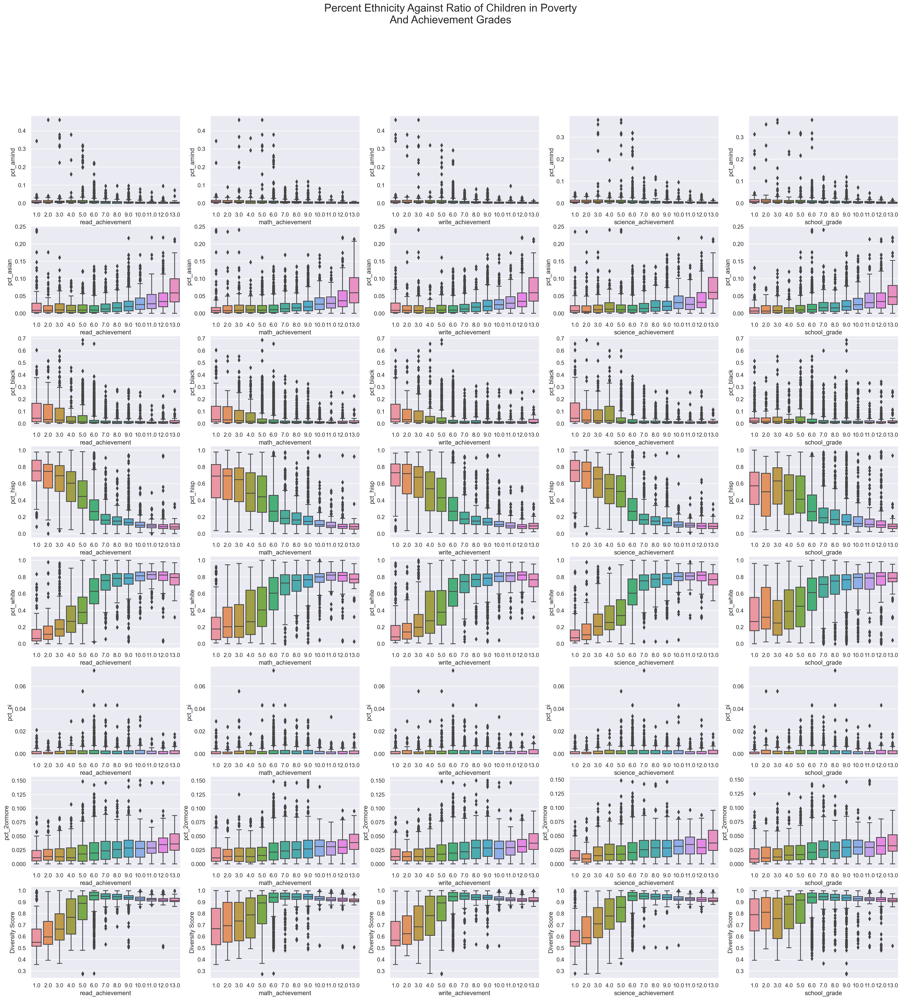

In [203]:
fig, ax = plt.subplots(len(ethnicities)+1,len(achievements), figsize=(30,30), dpi=200)
fig.suptitle('Percent Ethnicity Against Ratio of Children in Poverty\nAnd Achievement Grades',
            fontsize='xx-large')
for i in range(len(ethnicities)+1):
    for j in range(len(achievements)):
        sns.boxplot(data=all_data, y=(ethnicities+['Diversity Score'])[i], x=achievements[j], ax=ax[i,j])

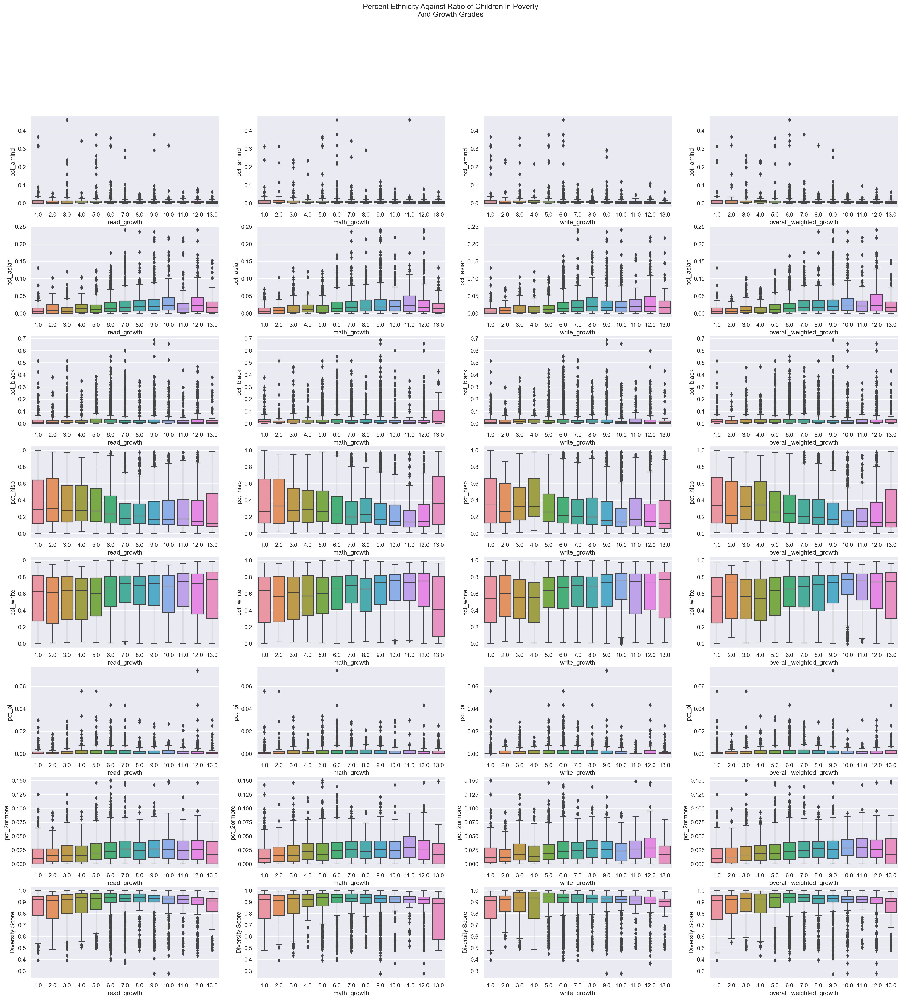

In [204]:
fig, ax = plt.subplots(len(ethnicities)+1,len(growths), figsize=(30,30), dpi=200)
fig.suptitle('Percent Ethnicity Against Ratio of Children in Poverty\nAnd Growth Grades')
for i in range(len(ethnicities)+1):
    for j in range(len(growths)):
        sns.boxplot(data=all_data, y=(ethnicities+['Diversity Score'])[i], x=growths[j], ax=ax[i,j])

## 6 Spending and Grades

### 6.1 Spending and college readiness

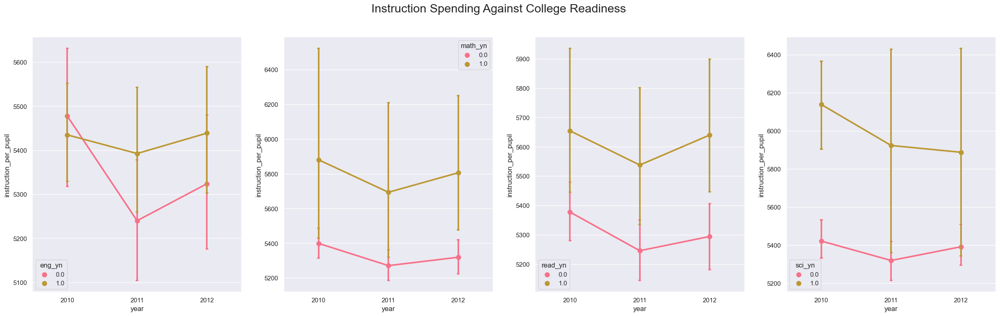

In [254]:
fig, ax = plt.subplots(1, len(college_readiness), figsize=(30,8), dpi=100)
fig.suptitle('Instruction Spending Against College Readiness',
            fontsize='xx-large')
for i in range(len(college_readiness)):
    sns.pointplot(data=high_school, hue=college_readiness[i], y='instruction_per_pupil', x='year', ax=ax[i], capsize=0.02)
plt.show()

In [46]:
eng_ready_loc = high_school['eng_yn'].astype('bool')
math_ready_loc = high_school['math_yn'].astype('bool')
read_ready_loc = high_school['read_yn'].astype('bool')
sci_ready_loc = high_school['sci_yn'].astype('bool')

spend_eng_ready = high_school.loc[eng_ready_loc, 'instruction_per_pupil'].dropna()
spend_not_eng_ready = high_school.loc[~(eng_ready_loc), 'instruction_per_pupil'].dropna()

spend_math_ready = high_school.loc[math_ready_loc, 'instruction_per_pupil'].dropna()
spend_not_math_ready = high_school.loc[~(math_ready_loc), 'instruction_per_pupil'].dropna()

spend_read_ready = high_school.loc[read_ready_loc, 'instruction_per_pupil'].dropna()
spend_not_read_ready = high_school.loc[~(read_ready_loc), 'instruction_per_pupil'].dropna()

spend_sci_ready = high_school.loc[sci_ready_loc, 'instruction_per_pupil'].dropna()
spend_not_sci_ready = high_school.loc[~(sci_ready_loc), 'instruction_per_pupil'].dropna()

In [247]:
eng_res = stats.mannwhitneyu(spend_not_eng_ready, spend_eng_ready, alternative='less')
math_res = stats.mannwhitneyu(spend_not_math_ready, spend_math_ready, alternative='less')
read_res = stats.mannwhitneyu(spend_not_read_ready, spend_read_ready, alternative='less')
sci_res =  stats.mannwhitneyu(spend_not_sci_ready, spend_sci_ready, alternative='less')

print('English Readines:', eng_res)
print('Math Readiness:', math_res)
print('Reading Readiness:', read_res)
print('Science Readiness:', sci_res)

p_vals = eng_res.pvalue, math_res.pvalue, read_res.pvalue, sci_res.pvalue

English Readines: MannwhitneyuResult(statistic=26739.0, pvalue=0.14142976826051173)
Math Readiness: MannwhitneyuResult(statistic=11957.0, pvalue=0.00021439059258831713)
Reading Readiness: MannwhitneyuResult(statistic=21147.0, pvalue=2.9136242426028342e-05)
Science Readiness: MannwhitneyuResult(statistic=1564.0, pvalue=6.0704343387803517e-05)


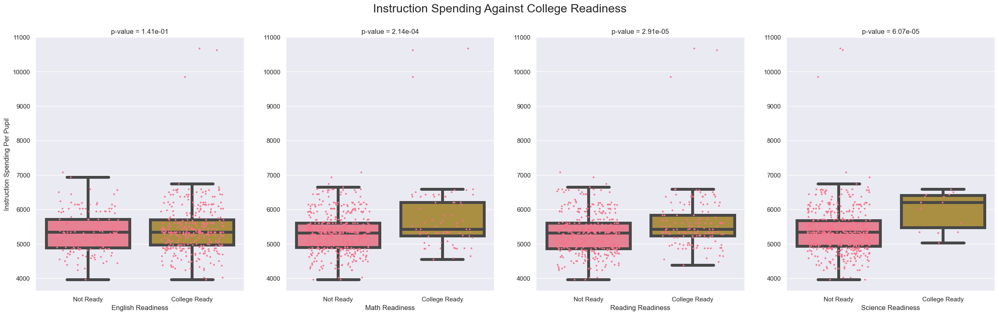

In [251]:
fig, ax = plt.subplots(1, len(college_readiness), figsize=(30,8), dpi=100)
fig.suptitle('Instruction Spending Against College Readiness',
            fontsize='xx-large')
for i in range(len(college_readiness)):
    sns.boxplot(data=high_school, x=college_readiness[i], y='instruction_per_pupil', ax=ax[i], linewidth=5, showfliers=False)
    sns.stripplot(data=high_school, x=college_readiness[i], y='instruction_per_pupil', ax=ax[i], jitter=0.3, size=3, dodge=True)
    ax[i].set_title(f'p-value = {p_vals[i]:0.2e}')
    ax[i].set_xticklabels(['Not Ready', 'College Ready'])
    ax[i].set_xlabel(college_readiness_names[i])
    if i > 0:
        ax[i].set_ylabel('')
    else:
        ax[i].set_ylabel('Instruction Spending Per Pupil')
plt.show()
fig.savefig('../reports/figures/spending_and_college_readiness.png')

In [405]:
# Add a boolean feature that indicates whether a school is majority white
all_data['Majority White'] = all_data['pct_white'] >= 0.5

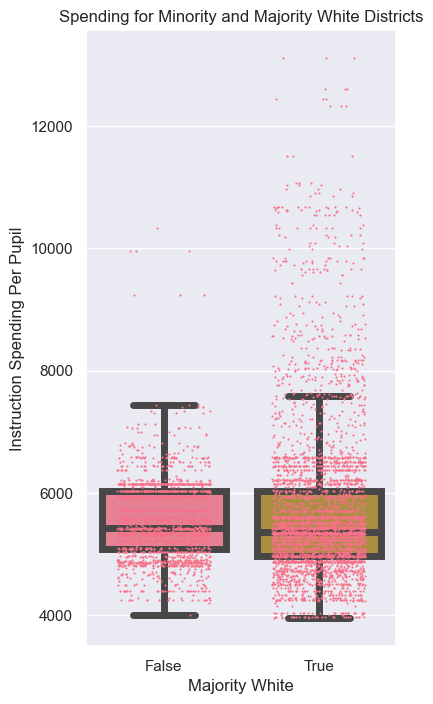

In [406]:
fig = plt.figure(figsize=(4,8), dpi=100)
sns.boxplot(data=all_data, x='Majority White', y='instruction_per_pupil',linewidth=5, showfliers=False)
sns.stripplot(data=all_data, x='Majority White', y='instruction_per_pupil', jitter=0.3, size=1.5)
plt.title('Spending for Minority and Majority White Districts')
plt.ylabel('Instruction Spending Per Pupil')
fig.savefig('../reports/figures/unfair_spending.png', bbox_inches='tight')
plt.show()

While it seems that average spending between majority and minority white schools is similar, majority white schools see far more outliers of high spending schools than minority white schools

In [239]:
maj_white_spending = all_data.loc[all_data['Majority White'], 'instruction_per_pupil'].dropna()
min_white_spending = all_data.loc[~(all_data['Majority White']), 'instruction_per_pupil'].dropna()

stats.ttest_ind(maj_white_spending, min_white_spending, alternative='greater')

Ttest_indResult(statistic=5.886045618463024, pvalue=2.0830613215581086e-09)

In [407]:
maj_white_spending

16      6143.0
33      6022.0
34      5939.0
36      6022.0
37      5939.0
         ...  
6088    5596.0
6089    5868.0
6095    5596.0
6096    5868.0
6097    6156.0
Name: instruction_per_pupil, Length: 4085, dtype: float64

In [409]:
min_white_spending

0       6022.0
1       5939.0
2       6143.0
3       6022.0
4       5939.0
         ...  
6091    6156.0
6092    5596.0
6093    5868.0
6094    6156.0
6098    5868.0
Name: instruction_per_pupil, Length: 2007, dtype: float64

In [51]:
# Schools that have received a C+ grade or better
all_data['Above Average Grade'] = all_data['school_grade'] >= 7

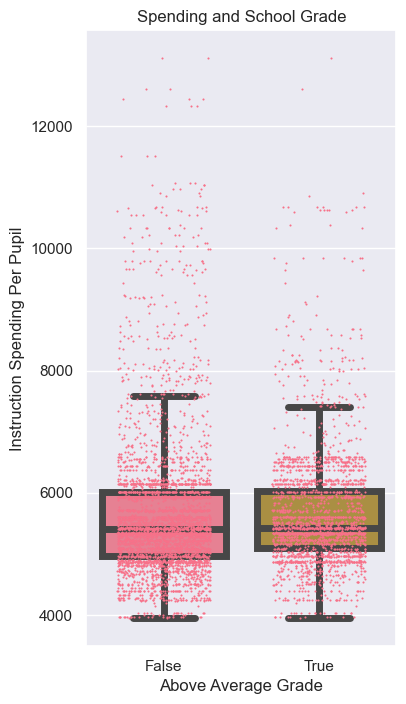

In [52]:
plt.figure(figsize=(4,8), dpi=100)
ax = sns.boxplot(data=all_data, x='Above Average Grade', y='instruction_per_pupil', linewidth=5, showfliers=False)
for patch in ax.artists:
 r, g, b, a = patch.get_facecolor()
 patch.set_facecolor((r, g, b, .01))
sns.stripplot(data=all_data, x='Above Average Grade', y='instruction_per_pupil', jitter=0.3, alpha=1, ax=ax, size=1.5)


plt.title('Spending and School Grade')
plt.ylabel('Instruction Spending Per Pupil')
plt.show()

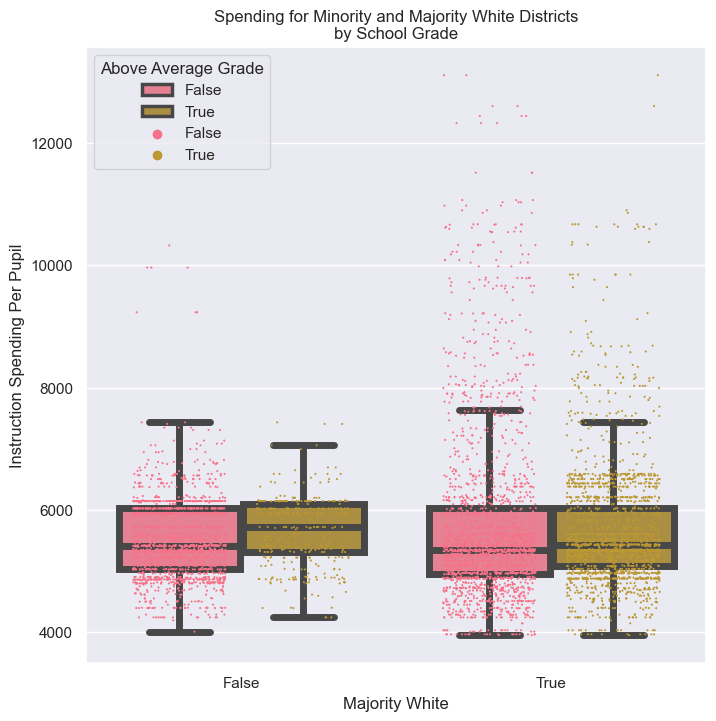

In [53]:
plt.figure(figsize=(8,8), dpi=100)
sns.boxplot(data=all_data, x='Majority White', y='instruction_per_pupil', hue='Above Average Grade', linewidth=5, showfliers=False)
sns.stripplot(data=all_data, x='Majority White', y='instruction_per_pupil', hue='Above Average Grade', dodge=True, size=1.5, jitter=0.3)
plt.title('Spending for Minority and Majority White Districts\nby School Grade')
plt.ylabel('Instruction Spending Per Pupil')
plt.show()

Furthermore, we see that majority white schools that have above average performance are able to spend more per pupil than minority white schools.

In [54]:
above_av_loc = all_data['Above Average Grade']
below_av_loc = ~(above_av_loc)

maj_white_loc = all_data['Majority White']
min_white_loc = ~(maj_white_loc)

In [55]:
maj_white = all_data.loc[maj_white_loc, 'instruction_per_pupil'].dropna()
min_white = all_data.loc[min_white_loc, 'instruction_per_pupil'].dropna()

above_average = all_data.loc[above_av_loc, 'instruction_per_pupil'].dropna()
below_average = all_data.loc[below_av_loc, 'instruction_per_pupil'].dropna()

maj_white_above = all_data.loc[(maj_white_loc) & (above_av_loc), 'instruction_per_pupil'].dropna()
maj_white_below = all_data.loc[(maj_white_loc) & (below_av_loc), 'instruction_per_pupil'].dropna()

min_white_above = all_data.loc[(min_white_loc) & (above_av_loc), 'instruction_per_pupil'].dropna()
min_white_below = all_data.loc[(maj_white_loc) & (below_av_loc), 'instruction_per_pupil'].dropna()

In [56]:
statistic = lambda x, y: np.mean(x) - np.mean(y)

print(statistic(below_average, above_average))
print(statistic(maj_white_below, maj_white_above))
print(statistic(min_white_below, min_white_above))

3.0979750862807123
122.68856182488162
122.71075858467157


In [57]:
stats.permutation_test((min_white, maj_white), statistic, alternative='less')

PermutationTestResult(statistic=-176.5061970984052, pvalue=0.0001, null_distribution=array([-27.46662581,   1.03024372,  11.5489182 , ...,  -3.43031032,
        -9.00990389,  -2.95475566]))

In [58]:
stats.permutation_test((below_average, above_average), statistic, alternative='less')

PermutationTestResult(statistic=3.0979750862807123, pvalue=0.5388, null_distribution=array([-49.28800151,  -2.80230847, -40.16073303, ...,  43.69091305,
        23.22642184,  27.32602729]))

In [59]:
stats.permutation_test((maj_white_below, maj_white_above), statistic, alternative='less')

PermutationTestResult(statistic=122.68856182488162, pvalue=0.9988, null_distribution=array([ 4.21107787e+01,  1.01729748e+01, -9.36824702e+00, ...,
       -4.76679447e+01,  3.09299237e+00,  1.78484666e-02]))

In [60]:
stats.permutation_test((min_white_below, min_white_above), statistic, alternative='less')

PermutationTestResult(statistic=122.71075858467157, pvalue=0.9403, null_distribution=array([ -69.60416068,  -37.12622623, -122.38462811, ...,  -22.33695435,
         59.21308265, -102.87407407]))

In [61]:
stats.ttest_ind(below_average, above_average, alternative='less')

Ttest_indResult(statistic=0.10734029281014851, pvalue=0.5427387220208504)

In [62]:
stats.ttest_ind(maj_white_below, maj_white_above, alternative='less')

Ttest_indResult(statistic=3.0973561180365805, pvalue=0.9990170944947208)

In [63]:
stats.ttest_ind(min_white_below, min_white_above, alternative='less')

Ttest_indResult(statistic=1.5256810199349373, pvalue=0.9363877970396677)

In order to uncover the pattern that increased instruction spending affects performance, we had to separate the data by ethnicity. Because of the differences in spending for majority and minority white schools, the pattern that more spending increases performance was obscured.

### Distribution of Spending

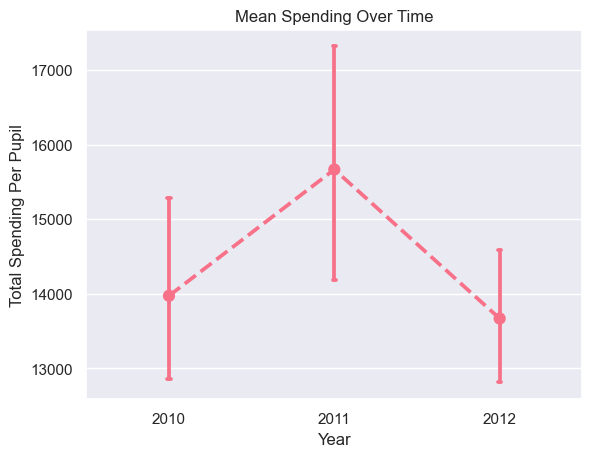

In [381]:
plt.figure(dpi=100)
sns.pointplot(data=district_data, x='year', y='sum_per_pupil', capsize=0.02, linestyles='--')
plt.title('Mean Spending Over Time')
plt.xlabel('Year')
plt.ylabel('Total Spending Per Pupil')
plt.show()

Sadly we are not observing that spending is increasing over time. That is worrisome considering we are confident that poverty is increasing. Plus, spending is clearly not meeting the rate of inflation

<Figure size 640x480 with 0 Axes>

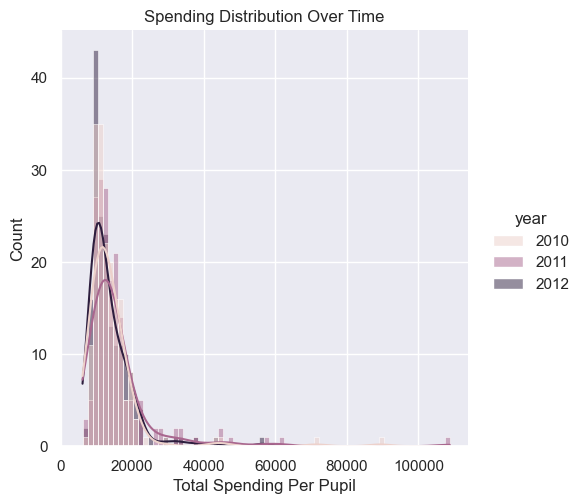

In [382]:
plt.figure(dpi=100)
sns.displot(data=district_data, x='sum_per_pupil', hue='year', kde=True)
plt.title('Spending Distribution Over Time')
plt.xlabel('Total Spending Per Pupil')
plt.xlim(left=0)
plt.show()

Furthermore, it seems that there still are issues with extreme outliers

In [395]:
spending_quantiles = district_data['sum_per_pupil'].quantile([0, 0.025, 0.25, 0.5, 0.75, 0.975, 1])
new_index = [f'{quantile * 100}%' for quantile in spending_quantiles.index]

new_values = [f'${val:0.2f}' for val in spending_quantiles.values]

new_quantiles = pd.Series(data=new_values, index=new_index, name='Total Spending Per Pupil')

print(new_quantiles)
new_quantiles.to_latex('../reports/tables/spending_quantiles.txt')

0.0%        $6090.00
2.5%        $8346.90
25.0%      $10116.25
50.0%      $12401.50
75.0%      $15827.00
97.5%      $36131.82
100.0%    $108789.00
Name: Total Spending Per Pupil, dtype: object


C:\Users\caeley\AppData\Local\Temp\ipykernel_17944\3252726979.py:9: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  new_quantiles.to_latex('../reports/tables/spending_quantiles.txt')


## 7 Performance

In [255]:
grade_labels = ('F', 'D-', 'D', 'D+', 'C-', 'C', 'C+', 'B-', 'B', 'B+', 'A-', 'A', 'A+')
grade_ticks = np.arange(13)

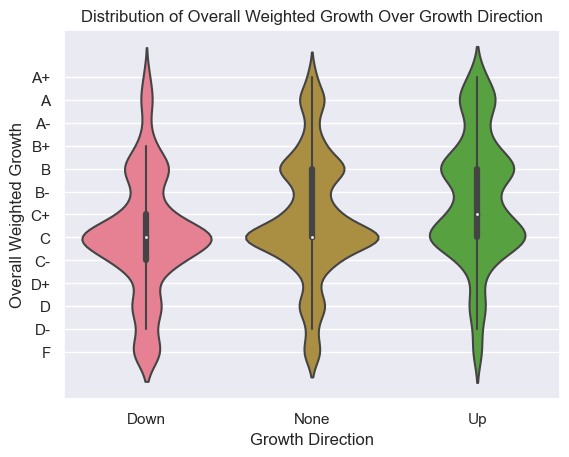

In [260]:
fig = plt.figure(dpi=100)
sns.violinplot(data=all_data, x='growth_dir', y='overall_weighted_growth')
# grouped = all_data.groupby('growth_dir')['overall_weighted_growth'].mean()
# grouped = grouped.reset_index()
# grouped['growth_dir'] = grouped['growth_dir'] + 1
# sns.lineplot(grouped, x='growth_dir', y='overall_weighted_growth', c='k', markers='o')\
plt.title('Distribution of Overall Weighted Growth Over Growth Direction')
plt.xticks(ticks=(0,1,2),labels=('Down', 'None', 'Up'))
plt.xlabel('Growth Direction')
plt.ylabel('Overall Weighted Growth')
plt.yticks(grade_ticks + 1, grade_labels)
plt.show()

In [65]:
all_2010 = all_data.loc[all_data['year'] == 2010, ['school_id', 'emh', 'overall_weighted_growth', 'school_grade']]
all_2011 = all_data.loc[all_data['year'] == 2011, ['school_id', 'emh', 'overall_weighted_growth', 'school_grade']]
all_2012 = all_data.loc[all_data['year'] == 2012, ['school_id', 'emh', 'overall_weighted_growth', 'school_grade']]

In [66]:
all_wide = pd.merge(all_2010, all_2011, on=['school_id', 'emh'], how='inner', suffixes=('_2010','_2011'))
all_wide = pd.merge(all_wide, all_2012, on=['school_id', 'emh'], how='inner', suffixes=('','_2012'))

In [67]:
all_wide['2011 Achievement Growth'] = all_wide['school_grade_2011'] - all_wide['school_grade_2010']
all_wide['2012 Achievement Growth'] = all_wide['school_grade'] - all_wide['school_grade_2011']

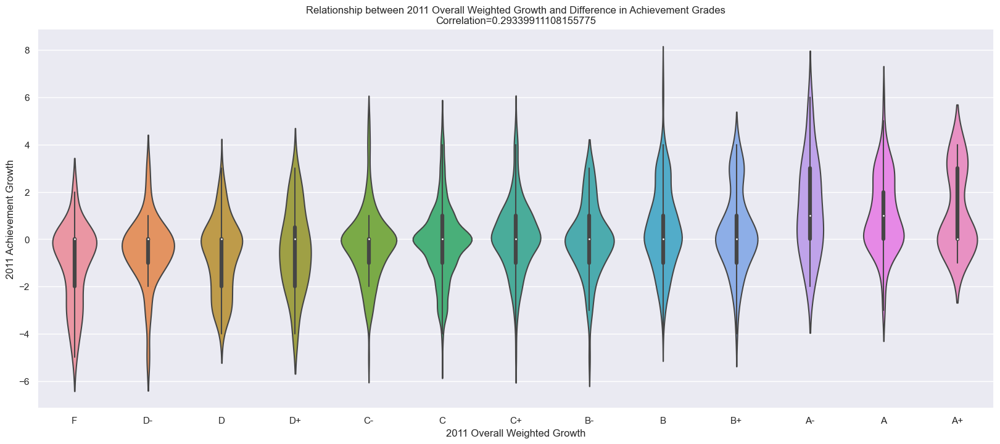

In [69]:
growth_corr = all_wide['overall_weighted_growth_2011'].corr(all_wide['2011 Achievement Growth'])
plt.figure(figsize=(20,8), dpi=100)
sns.violinplot(data=all_wide, x='overall_weighted_growth_2011', y='2011 Achievement Growth')
plt.title(f'Relationship between 2011 Overall Weighted Growth and Difference in Achievement Grades\nCorrelation={growth_corr}')
plt.xlabel('2011 Overall Weighted Growth')
plt.xticks(grade_ticks, grade_labels)
plt.show()

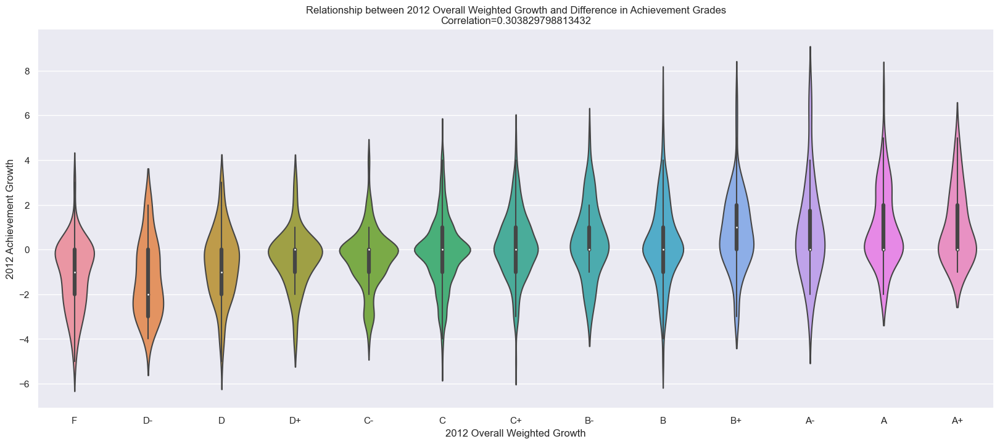

In [70]:
growth_corr = all_wide['overall_weighted_growth'].corr(all_wide['2012 Achievement Growth'])
plt.figure(figsize=(20,8), dpi=100)
sns.violinplot(data=all_wide, x='overall_weighted_growth', y='2012 Achievement Growth')
plt.title(f'Relationship between 2012 Overall Weighted Growth and Difference in Achievement Grades\nCorrelation={growth_corr}')
plt.xlabel('2012 Overall Weighted Growth')
plt.xticks(grade_ticks, grade_labels)
plt.show()